# Image Preprocessing for the LNDb Challenge (sub-challenge A)
#### By Clinton Lau, Donghao Qiao and Fraser Raney
## Libraries

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from tqdm import tqdm
# utils.py from the challenge
import utils
from PIL import Image
from skimage.exposure import equalize_hist
from medpy.filter.smoothing import anisotropic_diffusion

## Load the Data

In [3]:
# Change this line to the path to the data folders
data_fld = '.\Data'

# Change this line to the path to the gt csv, trainNodules_gt
gt_pth = '.'

In [4]:
data_folders = os.listdir(data_fld)
filepaths_imgs = []

for folder in data_folders:
    fldr = os.path.join(data_fld, folder)
    dir_lst = filter(lambda x: x.split('.')[-1] != 'raw', os.listdir(fldr))
    dir_lst = map(lambda x: os.path.join(fldr, x) ,list(dir_lst))
    filepaths_imgs.append(np.array(list(dir_lst)).reshape(-1,1))

filepaths_imgs = np.vstack(filepaths_imgs).reshape(-1,)
trainCSV = pd.read_csv(os.path.join(gt_pth,'trainNodules_gt.csv'))

In [5]:
trainCSV.head()

,LNDbID,RadID,RadFindingID,FindingID,x,y,z,AgrLevel,Nodule,Volume,Text
0,1,"1,2,3","1,1,1",1,-44.203451,-119.073242,-37.5,3,1,222.360697,5.0
1,1,1,2,2,25.852539,-126.969727,-45.5,1,1,152.381031,4.0
2,2,"1,2,3","1,1,3",1,88.895508,-123.867513,-129.5,3,1,378.042297,5.0
3,2,"1,3","2,2",2,63.534180,-112.756836,-117.5,2,1,174.844563,5.0
4,2,"1,3","3,5",3,-103.850586,-116.742188,-253.0,2,1,297.708309,5.0


In [6]:
annot = trainCSV[['LNDbID','x','y','z']]
tmp = []
for lnid in annot['LNDbID']:
    tmp.append([filepath for filepath in filepaths_imgs if str(lnid).zfill(4) in filepath][0])
annot['file'] = tmp

C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


# Show a sample image and label

In [30]:
def displayExample(index, colour=None, h_eq=None):
    sc, sp, o, t = utils.readMhd(annot['file'][index])
    t_img, t_wld = utils.getImgWorldTransfMats(sp, t)
    x = utils.convertToImgCoord(annot[['x','y','z']].iloc[index].values, o, t_img)
    print(x, sc.shape)

    z_pos = int(x[2])
    slide = sc[z_pos,:,:]
    if h_eq:
        slide = equalize_hist(slide)
        slide = anisotropic_diffusion(slide, voxelspacing=sp[1:], kappa=20, gamma=0.01, niter=100, option=2)

    if colour:
        # Red less than -900
        red = np.where(slide <= - 900, slide.min(), slide)
        red = 256 * (red - red.mean())/red.std()
        # Green (-900, 0]
        green = np.where((slide > - 900) & (slide <= 0), -900, slide)
        green = 256 * (green - green.mean())/green.std()
        # Blue (0, 300]
        blue = np.where((slide > 0) & (slide <= 300), 0, slide)
        blue = 256 * (blue - blue.mean())/blue.std()
        slide = np.dstack([red, green, blue])
    
    
    plt.figure(figsize=(9.6,9.6))
    plt.imshow(slide, cmap='gray')
    plt.plot(*x[:2], marker='X', c='red', markersize=20)
    plt.axis('off')
    #plt.title('Axial Slice %s of %s' % (int(x[2]), sc.shape[0]))

[198. 173.  85.] (328, 512, 512)


C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\medpy\filter\smoothing.py:155: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  deltas[i][slicer] = numpy.diff(out, axis=i)
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\medpy\filter\smoothing.py:164: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  matrices[i][slicer] = numpy.diff(matrices[i], axis=i)


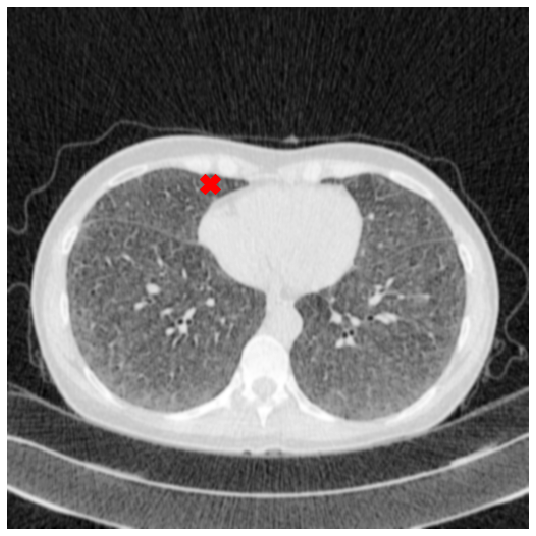

In [31]:
displayExample(22, h_eq=True)

In [9]:
trainCSV.head()

,LNDbID,RadID,RadFindingID,FindingID,x,y,z,AgrLevel,Nodule,Volume,Text
0,1,"1,2,3","1,1,1",1,-44.203451,-119.073242,-37.5,3,1,222.360697,5.0
1,1,1,2,2,25.852539,-126.969727,-45.5,1,1,152.381031,4.0
2,2,"1,2,3","1,1,3",1,88.895508,-123.867513,-129.5,3,1,378.042297,5.0
3,2,"1,3","2,2",2,63.534180,-112.756836,-117.5,2,1,174.844563,5.0
4,2,"1,3","3,5",3,-103.850586,-116.742188,-253.0,2,1,297.708309,5.0


# Save the dataset files
## * the axial slides with annotations 
## * labels in YOLO format [cls x y w h]
### Store necessary information for postprocessing into LNDb Challenge submission format, i.e., [scan id,  nodule prob, x pos, y pos, z pos]
* Original image shape
* LNDb ID (filename)
* Z-Axis position of Slice/Label

## Grayscale normalized [0, 255] single axial slides

In [34]:
if not os.path.isdir('imagesTr'):
    os.mkdir('imagesTr')

In [35]:
if not os.path.isdir('TransM'):
    os.mkdir('TransM')

In [36]:
gts = trainCSV[['LNDbID', 'x','y','z']]
xyz = []
radii = []
trFiles = []
t_wlds = []
origins = []
id_c = 1
id_n = 0
input_shapes = []

for index in tqdm(range(len(annot))):
    sc, sp, o, t = utils.readMhd(annot['file'][index])
    origins.append(o)
    t_img, t_wld = utils.getImgWorldTransfMats(sp, t)
    x = utils.convertToImgCoord(annot[['x','y','z']].iloc[index].values, o, t_img)
    radii.append((trainCSV['Volume'][index] * (0.75) / np.pi) ** (1. / 3) / 512)
    input_shapes.append(sc.shape)
#    slide = sc[int(x[2]),:,:]
   
    if sc.shape[1:] != (512, 512):
        zoom_factors = np.array((512, 512)) / np.array(sc.shape[1:])
#        slide = zoom(slide, zoom_factors)
        x[:2] *= np.flip(zoom_factors)
    
    if id_c != annot['LNDbID'][index]:
        id_n = 0
        id_c = annot['LNDbID'][index]
    
    x[:2] /= 512
    xyz.append(x)
    filename = 'tr-%s-%s.jpg' % (str(annot['LNDbID'][index]).zfill(4), str(id_n).zfill(4))
    trFiles.append(filename)
    t_wlds.append(filename[:-4])
    np.save(os.path.join('.\TransM', filename[:-4]), t_wld)
#    plt.figure(dpi=100).set_size_inches(6.79,6.79)
#    plt.imshow(slide, cmap='gray')
#    plt.axis('off')
#    plt.savefig(os.path.join('.\imagesTr', filename), bbox_inches='tight', pad_inches=0, dpi=100)
    id_n += 1
    
gts[['x','y','z']] = pd.DataFrame(xyz) 

gts['w'] = pd.Series(radii)
gts['h'] = pd.Series(radii)
gts['file'] = pd.Series(trFiles)
gts['orig shp'] = pd.Series(input_shapes)
gts['origin'] = pd.Series(origins)
gts['t_wrld'] = pd.Series(t_wlds)


  8%|███▏                                    | 97/1219 [01:42<16:21,  1.14it/s]


 16%|██████▏                                | 195/1219 [03:09<13:48,  1.24it/s]


 24%|█████████▎                             | 293/1219 [04:47<15:53,  1.03s/it]


 32%|████████████▌                          | 391/1219 [06:36<25:06,  1.82s/it]


 40%|███████████████▋                       | 489/1219 [08:25<11:45,  1.04it/s]


 48%|██████████████████▊                    | 587/1219 [10:37<10:02,  1.05it/s]


 56%|█████████████████████▉                 | 685/1219 [12:06<06:03,  1.47it/s]


 64%|█████████████████████████              | 783/1219 [13:55<07:46,  1.07s/it]


 72%|████████████████████████████▏          | 881/1219 [15:49<07:23,  1.31s/it]


 80%|███████████████████████████████▎       | 979/1219 [17:27<02:58,  1.34it/s]


 88%|█████████████████████████████████▌    | 1077/1219 [19:14<02:09,  1.10it/s]


 96%|████████████████████████████████████▋ | 1175/1219 [20:59<00:55,  1.26s/it]


100%|██████████████████████████████████████| 1219/1219 [21:44<00:00,  1.07s/it]
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\pandas\core\frame.py:3509: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\ipykernel_launcher.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\ipykernel_launcher.py:44: SettingWithCopyWarning: 
A value is trying to be set on

## Colour-coded (KAMP paper-style) axial slides

In [ ]:
if not os.path.isdir('colourTr'):
    os.mkdir('colourTr')

In [ ]:
gts = trainCSV[['LNDbID', 'x','y','z']]
xyz = []
radii = []
trFiles = []
t_wlds = []
origins = []
id_c = 1
id_n = 0
input_shapes = []

for index in tqdm(range(len(annot))):
    sc, sp, o, t = utils.readMhd(annot['file'][index])
    origins.append(o)
    t_img, t_wld = utils.getImgWorldTransfMats(sp, t)
    x = utils.convertToImgCoord(annot[['x','y','z']].iloc[index].values, o, t_img)
    radii.append((trainCSV['Volume'][index] * (0.75) / np.pi) ** (1. / 3) / 512)
    input_shapes.append(sc.shape)
    slide = sc[int(x[2]),:,:]
   
    if sc.shape[1:] != (512, 512):
        zoom_factors = np.array((512, 512)) / np.array(sc.shape[1:])
        slide = zoom(slide, zoom_factors)
        x[:2] *= np.flip(zoom_factors)
        
    # Red less than -900
    red = np.where(slide <= -900, slide.min(), slide)
    red = 256 * (red - red.mean())/red.std()
    # Green (-900, 0]
    green = np.where((slide > -900) & (slide <= 0), -900, slide)
    green = 256 * (green - green.mean())/green.std()
    # Blue (0, 300]
    blue = np.where((slide > 0) & (slide <= 300), 0, slide)
    blue = 256 * (blue - blue.mean())/blue.std()
    slide = np.dstack([red, green, blue])
    
    if id_c != annot['LNDbID'][index]:
        id_n = 0
        id_c = annot['LNDbID'][index]
    
    x[:2] /= 512
    xyz.append(x)
    filename = 'tr-%s-%s.jpg' % (str(annot['LNDbID'][index]).zfill(4), str(id_n).zfill(4))
    trFiles.append(filename)
    t_wlds.append(filename[:-4])
    np.save(os.path.join('.\TransM', filename[:-4]), t_wld)
    plt.figure(dpi=100).set_size_inches(6.79,6.79)
    plt.imshow(slide)
    plt.axis('off')
    plt.savefig(os.path.join('.\colourTr', filename), bbox_inches='tight', pad_inches=0, dpi=100)
    id_n += 1
    
gts[['x','y','z']] = pd.DataFrame(xyz) 

gts['w'] = pd.Series(radii)
gts['h'] = pd.Series(radii)
gts['file'] = pd.Series(trFiles)
gts['orig shp'] = pd.Series(input_shapes)
gts['origin'] = pd.Series(origins)
gts['t_wrld'] = pd.Series(t_wlds)

## 3 adjacent grayscale axial slides

In [ ]:
if not os.path.isdir('sliceTr'):
    os.mkdir('sliceTr')

  0%|                                                 | 0/1219 [00:00<?, ?it/s]C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\medpy\filter\smoothing.py:155: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  deltas[i][slicer] = numpy.diff(out, axis=i)
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\medpy\filter\smoothing.py:164: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  matrices[i][slicer] = numpy.diff(matrices[i], axis=i)
  6%|██                                    | 68/1219 [14:08<3:32:34, 11.08s/it]

KeyboardInterrupt: 

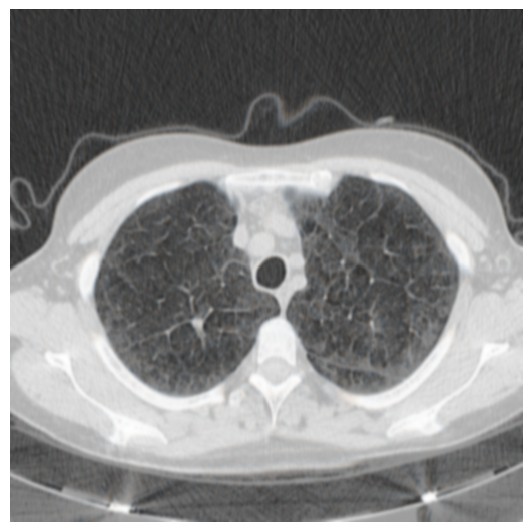

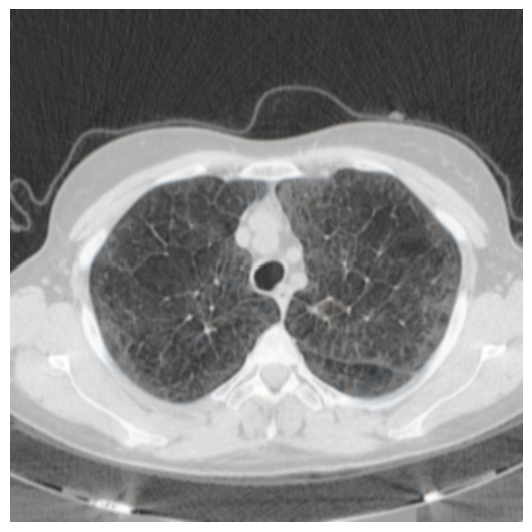

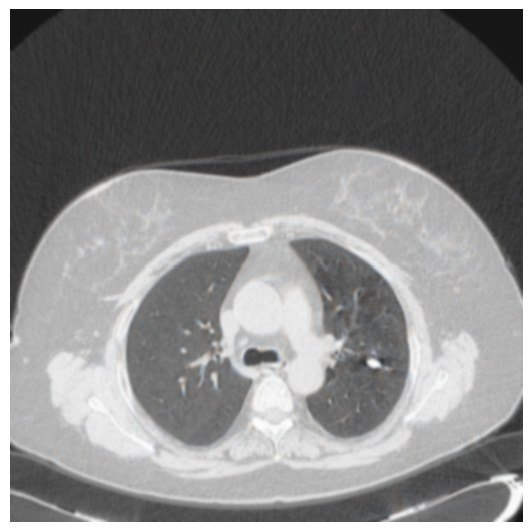

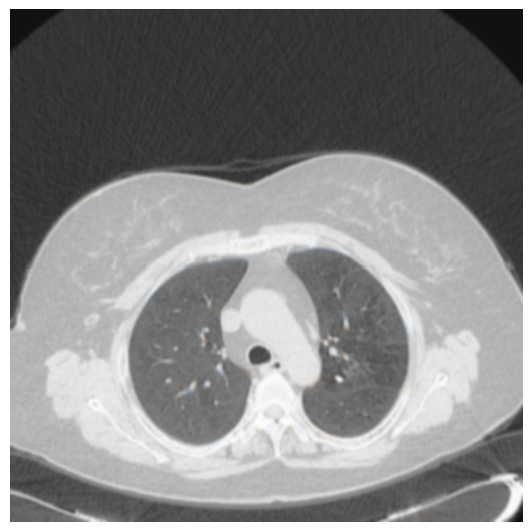

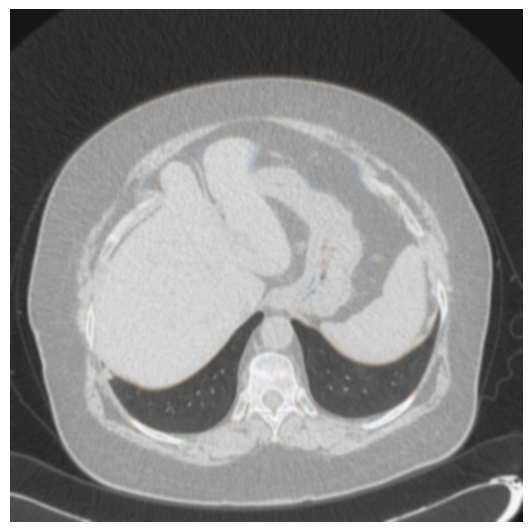

...

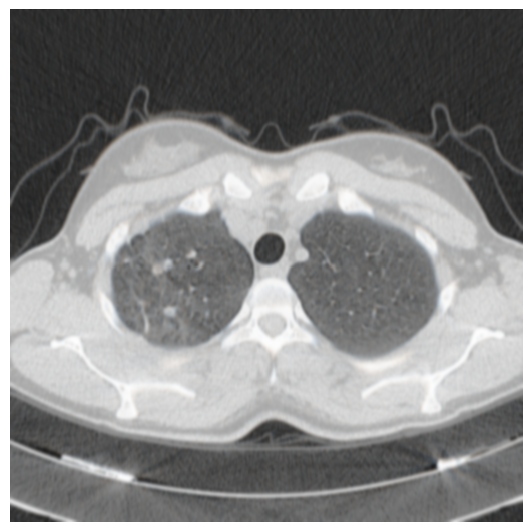

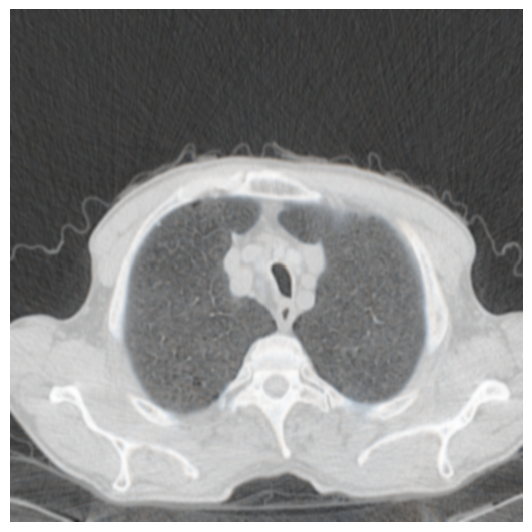

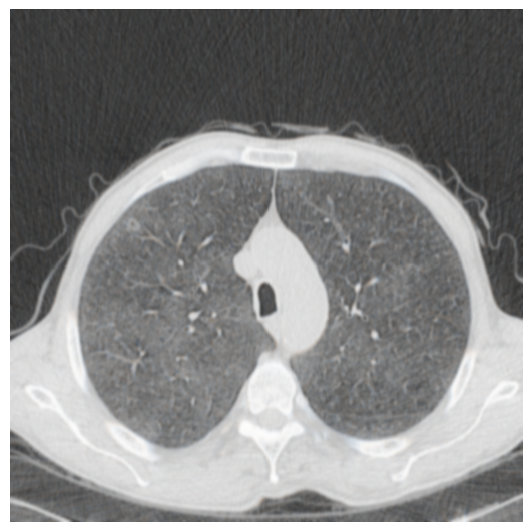

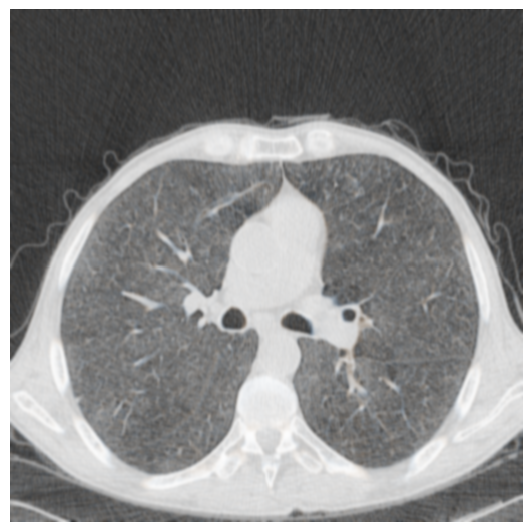

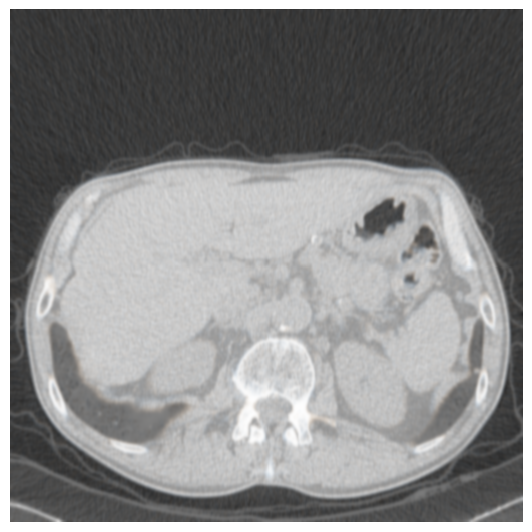

Error in callback <function flush_figures at 0x000001DC021781F8> (for post_execute):


KeyboardInterrupt: 

In [10]:
gts = trainCSV[['LNDbID', 'x','y','z']]
xyz = []
radii = []
trFiles = []
t_wlds = []
origins = []
id_c = 1
id_n = 0
input_shapes = []

for index in tqdm(range(len(annot))):
    sc, sp, o, t = utils.readMhd(annot['file'][index])
    origins.append(o)
    t_img, t_wld = utils.getImgWorldTransfMats(sp, t)
    x = utils.convertToImgCoord(annot[['x','y','z']].iloc[index].values, o, t_img)
    radii.append((trainCSV['Volume'][index] * (0.75) / np.pi) ** (1. / 3) / 512)
    input_shapes.append(sc.shape)
    slide = sc[int(x[2])-1:int(x[2])+2,:,:]
    slide = equalize_hist(slide)
    slide = anisotropic_diffusion(slide, voxelspacing=sp, kappa=20, gamma=0.01, niter=100, option=2)
    
    if sc.shape[1:] != (512, 512):
        zoom_factors = np.array((512, 512)) / np.array(sc.shape[1:])
        slide_a = zoom(slide[0], zoom_factors)
        slide_b = zoom(slide[1], zoom_factors)
        slide_c = zoom(slide[2], zoom_factors)
        slide = np.dstack([slide_a, slide_b, slide_c])
        x[:2] *= np.flip(zoom_factors)
    else:
        slide = np.dstack([slide[0], slide[1], slide[2]])
        
    if id_c != annot['LNDbID'][index]:
        id_n = 0
        id_c = annot['LNDbID'][index]
    
    x[:2] /= 512
    xyz.append(x)
    filename = 'tr-%s-%s.jpg' % (str(annot['LNDbID'][index]).zfill(4), str(id_n).zfill(4))
    trFiles.append(filename)
    t_wlds.append(filename[:-4])
    np.save(os.path.join('.\TransM', filename[:-4]), t_wld)
    plt.figure(dpi=100).set_size_inches(6.79,6.79)
    plt.imshow(slide)
    plt.axis('off')
    plt.savefig(os.path.join('.\sliceTr', filename), bbox_inches='tight', pad_inches=0, dpi=100)
    id_n += 1
    
gts[['x','y','z']] = pd.DataFrame(xyz) 

gts['w'] = pd.Series(radii)
gts['h'] = pd.Series(radii)
gts['file'] = pd.Series(trFiles)
gts['orig shp'] = pd.Series(input_shapes)
gts['origin'] = pd.Series(origins)
gts['t_wrld'] = pd.Series(t_wlds)

#  Save the ground truth information for training

In [37]:
gts['lblIndex'] = pd.Series(trainCSV['Nodule'])

In [38]:
trainTXT = gts[['lblIndex','x','y','w','h']]
trainTXT['w'] = trainTXT['w'].max() * 2
trainTXT['h'] = trainTXT['h'].max() * 2
for i in range(len(gts['file'])):
    np.savetxt(r'.\labels_txt\%s.txt' % (gts['file'][i].split('.')[0]), np.array([trainTXT.iloc[i].values]), fmt=['%d','%f','%f','%f','%f'])

C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\user\Anaconda3\envs\py3.6_workspace\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [39]:
gts.head(50)

,LNDbID,x,y,z,w,h,file,orig shp,origin,t_wrld,lblIndex
0,1,0.367188,0.611328,260.0,0.007340,0.007340,tr-0001-0000.jpg,"(328, 512, 512)","(-158.1962890625, -309.1962890625, -297.5)",tr-0001-0000,1
1,1,0.591797,0.585938,252.0,0.006472,0.006472,tr-0001-0001.jpg,"(328, 512, 512)","(-158.1962890625, -309.1962890625, -297.5)",tr-0001-0001,1
2,2,0.708984,0.691406,170.0,0.008761,0.008761,tr-0002-0000.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0000,1
3,2,0.640625,0.720703,182.0,0.006775,0.006775,tr-0002-0001.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0001,1
4,2,0.189453,0.710938,46.0,0.008090,0.008090,tr-0002-0002.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0002,1
5,2,0.652344,0.767578,218.0,0.004582,0.004582,tr-0002-0003.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0003,1
6,2,0.589844,0.691406,236.0,0.003398,0.003398,tr-0002-0004.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0004,1
7,2,0.787109,0.697266,90.0,0.002930,0.002930,tr-0002-0005.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0005,1
8,2,0.705078,0.697266,192.0,0.008813,0.008813,tr-0002-0006.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0006,1
9,2,0.710938,0.597656,129.0,0.004926,0.004926,tr-0002-0007.jpg,"(263, 512, 512)","(-174.1376953125, -380.1376953125, -299.5)",tr-0002-0007,1


In [40]:
gts.to_csv('GTS.csv')